## Shell Contact Example

In [1]:
# !pip install debugpy

In [2]:
import numpy as np

import dismech


geom = dismech.GeomParams(rod_r0=0.005,
                          shell_h=0.005)

material = dismech.Material(density=1200,
                            youngs_rod=0,
                            youngs_shell=2e10,
                            poisson_rod=0,
                            poisson_shell=0.5)

shell_contact_sim = dismech.SimParams(static_sim=False,
                                  two_d_sim=False,   # no twisting
                                  use_mid_edge=False,
                                  use_line_search=False,
                                  show_floor=False,
                                  log_data=True,
                                  log_step=1,
                                  dt=2e-3,
                                  max_iter=100,
                                  total_time=3,
                                  plot_step=1,
                                  tol=1e-4,
                                  ftol=1e-4,
                                  dtol=1e-2)

env = dismech.Environment()
# env.add_force('gravity', g=np.array([0.0, 0.0, 0]))
env.add_force('damping', eta = 100)
# # env.add_force('aerodynamics', rho=1000, cd=1)
env.add_force('hydrodynamics', rho=1000, cd=0.2)
env.add_force('thrust', thrust_coeff = 1000)

# env.add_force('selfContact', delta=0.01*2*5e-3, h=5e-3)
# env.set_static()  

# geo = dismech.Geometry.from_txt('input hemisphere more dense.txt')
geo = dismech.Geometry.from_txt('input_radially_sym_hemisphere.txt')
# geo = dismech.Geometry.from_txt('input hemisphere most dense.txt')

robot = dismech.SoftRobot(geom, material, geo, shell_contact_sim, env)

In [3]:
log_node = np.array(np.where(
    robot.state.q[robot.node_dof_indices].reshape(-1, 3)[:, 2] >= 0.999)[0])

In [4]:
print("# nodes: ", np.shape(robot.nodes))
print("# faces: ", np.shape(robot.face_nodes_shell))

# nodes:  (89, 3)
# faces:  (152, 3)


### Time Stepping

As we are performing a static simulation, we must change gravity for each time step.

In [5]:
stepper = dismech.ImplicitEulerTimeStepper(robot)

In [6]:
from scipy.signal import sawtooth

def actuate_jellyfish(robot, t):
    pulse_freq = 4            # Hz
    pulse_amplitude = 4*np.pi/5    # radians
    theta_rest = 0.0

    T = 1.0 / pulse_freq
    s = 0.5 * (1 - sawtooth(2 * np.pi * t / T, width=0.3))  # asymmetric cycle
    theta_base = theta_rest - pulse_amplitude * s

    n_hinges = robot.hinge_springs.inc_strain.shape[0]
    theta_bars = np.zeros(n_hinges)

    apex_z = np.max(robot.state.q[:robot.end_node_dof_index].reshape(-1, 3)[:, 2]) # max height of the apex
    xy_coords = robot.state.q[:robot.end_node_dof_index].reshape(-1, 3)[:, :2]
    radii = np.linalg.norm(xy_coords, axis=1)
    base_radius = np.max(radii)

    for i in range(n_hinges):
        n1, n2 = robot.hinge_springs.nodes_ind[i, 0:2]
        p1 = robot.state.q[robot.map_node_to_dof(n1)]
        p2 = robot.state.q[robot.map_node_to_dof(n2)]
        midpoint = 0.5 * (p1 + p2)

        r = np.linalg.norm(midpoint[:2]) / base_radius  # normalized radial distance
        z = midpoint[2] / apex_z                        # normalized height

        # Optional: add a temporal traveling wave (e.g. delay based on z)
        phase_delay = 0.1 * z  # tweak this coefficient as needed
        theta = theta_rest - pulse_amplitude * 0.5 * (1 - sawtooth(2 * np.pi * (t - phase_delay) / T, width=0.3))

        # if r < 0.5: 
        #     theta = theta_rest - 2*pulse_amplitude * 0.5 * (1 - sawtooth(2 * np.pi * (t - phase_delay) / T, width=0.3))

        # Scaling actuation by radial position (smoothstep)
        # scale = 3 * r**2 - 2 * r**3
        scale = 1

        theta_bars[i] = theta * scale

    robot.hinge_springs.inc_strain = theta_bars
    return robot

stepper.before_step = actuate_jellyfish

In [7]:
# from scipy.signal import sawtooth
# import numpy as np

# # One-time preprocessing function to compute tangential hinge mask
# def compute_tangential_mask(robot, angle_threshold_deg=15.0):
#     hinges = robot.hinge_springs.nodes_ind[:, 0:2]
#     q_nodes = robot.state.q[:robot.end_node_dof_index].reshape(-1, 3)
#     tangential_mask = np.zeros(len(hinges), dtype=bool)

#     for i, (n1, n2) in enumerate(hinges):
#         p1 = q_nodes[n1]
#         p2 = q_nodes[n2]
#         mid = 0.5 * (p1 + p2)

#         hinge_vec = p2 - p1
#         hinge_vec /= np.linalg.norm(hinge_vec)

#         radial_vec = mid / np.linalg.norm(mid)

#         angle_cos = np.dot(hinge_vec, radial_vec)
#         angle_deg = np.degrees(np.arccos(np.clip(np.abs(angle_cos), -1.0, 1.0)))

#         if angle_deg > (90 - angle_threshold_deg):
#             tangential_mask[i] = True

#     return tangential_mask


# # Precompute tangential hinge mask ONCE
# robot.tangential_hinge_mask = compute_tangential_mask(robot)


# # Modified actuation function
# def actuate_jellyfish(robot, t):
#     pulse_freq = 4                   # Hz
#     pulse_amplitude = np.pi   # radians
#     theta_rest = 0.0

#     T = 1.0 / pulse_freq
#     s = 0.5 * (1 - sawtooth(2 * np.pi * t / T, width=0.3))  # asymmetric contraction
#     theta_base = theta_rest - pulse_amplitude * s

#     n_hinges = robot.hinge_springs.inc_strain.shape[0]
#     theta_bars = np.zeros(n_hinges)

#     q_nodes = robot.state.q[:robot.end_node_dof_index].reshape(-1, 3)
#     apex_z = np.max(q_nodes[:, 2])
#     radii = np.linalg.norm(q_nodes[:, :2], axis=1)
#     base_radius = np.max(radii)

#     for i in range(n_hinges):
#         if not robot.tangential_hinge_mask[i]:
#             continue  # skip non-tangential hinges

#         n1, n2 = robot.hinge_springs.nodes_ind[i, 0:2]
#         p1 = q_nodes[n1]
#         p2 = q_nodes[n2]
#         midpoint = 0.5 * (p1 + p2)

#         r = np.linalg.norm(midpoint[:2]) / base_radius
#         z = midpoint[2] / apex_z

#         # traveling wave with delay based on height
#         phase_delay = 0.1 * z
#         theta = theta_rest - pulse_amplitude * 0.5 * (1 - sawtooth(2 * np.pi * (t - phase_delay) / T, width=0.3))

#         # scale actuation by radial location
#         scale = 3 * r**2 - 2 * r**3
#         theta_bars[i] = theta * scale

#     robot.hinge_springs.inc_strain = theta_bars
#     return robot

# # Assign the stepper callback
# stepper.before_step = actuate_jellyfish


In [8]:
print(robot.hinge_springs.inc_strain.shape)

(216,)


In [9]:
robots = stepper.simulate()

qs = np.stack([robot.state.q for robot in robots])

17565.40717667608
141943.91810134926
3814.275906840626
16571.425755065506
52.61024849041596
2.396931886606283
current_time:  0.002
6253.323245513035
893282.3685472416
8467.434193892941
6880.770222668955
204.60112016146857
3.0380420607309775
current_time:  0.004
8050.81096802411
1099244.3954191555
10247.265220578438
4635.969942412392
239.42058885789947
3.6451637540123922
current_time:  0.006
8815.1348795539
1059707.0562798784
8112.778353757524
1273.1072366237695
36.08798232275916
current_time:  0.008
8823.947177205539
923904.0050454754
5482.035224474608
252.41659379841914
4.6092118252220535
current_time:  0.01
8407.56563167673
786403.9257935116
3623.2992483230432
148.06821731860305
3.3580609280903313
current_time:  0.012
7881.170166605311
642619.58699802
2271.0619781535397
19.618707775247895
current_time:  0.014
7605.681016340421
587948.0183611208
2352.625893561174
478.1032904934668
3.167224531426831
current_time:  0.016
7762.4549238307045
635497.8064974947
3522.221140604828
997.6381780

[[-3.48114412e-17 -3.86283469e-18  1.00007380e+00]
 [-2.29557073e-17 -1.68548876e-17  1.00037732e+00]
 [ 1.49564967e-17  4.72118801e-17  1.00079462e+00]
 ...
 [-3.38110027e-17 -1.21073514e-16  1.85984439e+00]
 [-3.27060270e-17 -1.26947301e-16  1.86084727e+00]
 [-8.61413233e-18 -1.03478467e-16  1.86184895e+00]]


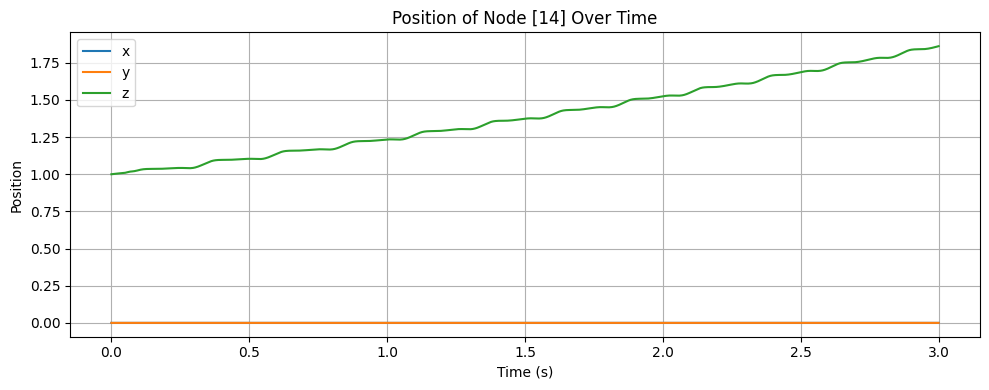

In [10]:
import matplotlib.pyplot as plt

# Extract the DOF indices (x, y, z) of the node you want to track
log_node_dofs = robot.map_node_to_dof(log_node)  # e.g., [ix, iy, iz]

# Extract position of that node across all timesteps
logged = qs[:, log_node_dofs].squeeze()  # shape (n_timesteps, 3)

# Plot x, y, z over time
t = np.arange(qs.shape[0]) * robot.sim_params.dt

print(logged)

plt.figure(figsize=(10, 4))
plt.plot(t, logged[:, 0], label='x')
plt.plot(t, logged[:, 1], label='y')
plt.plot(t, logged[:, 2], label='z')
plt.xlabel('Time (s)')
plt.ylabel('Position')
plt.title(f'Position of Node {log_node} Over Time')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


In [11]:
t = np.arange(robot.sim_params.total_time, step=robot.sim_params.dt)
options = dismech.AnimationOptions(title='Shell contact p2p', plot_step=5)

fig = dismech.get_interactive_animation_plotly(robot, t, qs, options)
fig.show()

301


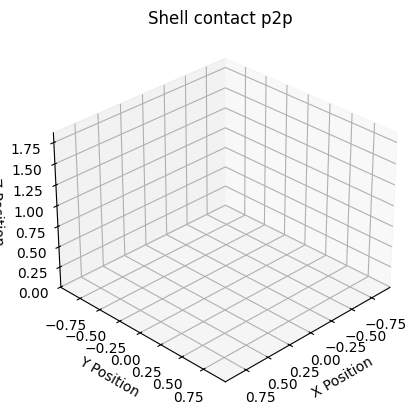

In [12]:
ani = dismech.get_animation(robot, t, qs, options)
ani.save('jellyfish.gif')